# Project 1 - Network Centrality and Categorical Data
###### Stefano Biguzzi, Dennis Pong, Ian Costello

## Assignment Description

For your first project, you are asked to:

1. Identify and load a network dataset that has some categorical information available for each node.
2. For each of the nodes in the dataset, calculate degree centrality and eigenvector centrality.
3. Compare your centrality measures across your categorical groups.

For example, using the dataset from a study of romantic relationships among high school students in Columbus, Ohio [http://researchnews.osu.edu/archive/chains.htm], you might want to determine if there are any differences in your calculated centrality measures between the two sexes.  You might use a t-test or another statistical measure to support your findings.

You may work in a small group.  Your project should be delivered in an Jupyter Notebook, and posted in GitHub.  Your project is due end of day Sunday. You and your team should created a video presentation about your project. You should be ready to present your project in our Meet-up.

## Assignment Steps

### Loading Libraries
First import the libraries necessary for this assignment: `networkx` as "nx", We also import `pandas`, `matplotlib`, and a few other helpful libraries to assist in presentation and display.

In [1]:
import networkx as nx
import pandas as pd
from itertools import islice
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.pyplot import figure
from tabulate import tabulate
from collections import Counter
from operator import itemgetter
import researchpy as rp
import numpy as np
import scipy.stats as stats
import warnings
warnings.filterwarnings('ignore')

### Data Wrangling

The data for this project came from the Standford SNAP page and is based on [Twitch data](https://snap.stanford.edu/data/twitch-social-networks.html). Twitch is a popular streaming platform for video gamers. The data itself were used to conduct supervised learned to determine if streams contained explicit language. 

For this project we are using language as our categorical variable. Helpfully, each language is its own file, and so we're able to load it in quite easily. 

The edge data created new IDs for each user to make the from -> to connection fairly straightforward. For each file, user IDs were replaced with sequential numbers starting at zero. To ensure we knew which language was which, we created a new column with the language abbreviation at the beginning, "DE" for German, "RU" for Russian, and "EN" for English. All three files were then placed into a single data frame to provide an overview of the entire network.

The datasets below were subsetted to 1,500 records each to cut down on processing time. Through experimentation, seemingly anything above 2,000 records per file made the workbook run particularly slow. 

In [2]:
de_url = 'https://raw.githubusercontent.com/iscostello/data620/main/Assignments/Project1/musae_DE_edges.csv'
de_twitch_data = pd.read_csv(de_url,header=0)[:1500]
de_twitch_data['from_new'] = 'DE' + de_twitch_data['from'].astype(str)
de_twitch_data['language'] = 'German'
de_twitch_data = de_twitch_data[['from_new','to','language']]


de_twitch_data.head()

,from_new,to,language
0,DE0,9206,German
1,DE0,7787,German
2,DE0,2145,German
3,DE0,2684,German
4,DE0,7275,German


In [3]:
en_url = 'https://raw.githubusercontent.com/iscostello/data620/main/Assignments/Project1/musae_ENGB_edges.csv'
en_twitch_data = pd.read_csv(en_url,header=0)[:1500]
en_twitch_data['from_new'] = 'EN' + en_twitch_data['from'].astype(str)
en_twitch_data['language'] = 'English'
en_twitch_data = en_twitch_data[['from_new','to','language']]


en_twitch_data.head()

,from_new,to,language
0,EN6194,255,English
1,EN6194,980,English
2,EN6194,2992,English
3,EN6194,2507,English
4,EN6194,986,English


In [4]:
ru_url = 'https://raw.githubusercontent.com/iscostello/data620/main/Assignments/Project1/musae_RU_edges.csv'
ru_twitch_data = pd.read_csv(ru_url,header=0)[:1500]
ru_twitch_data['from_new'] = 'RU' + ru_twitch_data['from'].astype(str)
ru_twitch_data['language'] = 'Russian'
ru_twitch_data = ru_twitch_data[['from_new', 'to', 'language']]


ru_twitch_data.head()

,from_new,to,language
0,RU0,646,Russian
1,RU0,2510,Russian
2,RU0,2425,Russian
3,RU0,2596,Russian
4,RU0,85,Russian


In [5]:
all_lang = pd.concat([de_twitch_data, en_twitch_data, ru_twitch_data])

## Setting Network Graphs

The network displayed below are all three languages drawn in the "shell" style network. For such a large about of records, it makes it easy to see the groupings of languages and streams. We didn't anticipate that much crossover between languages, but this network shown in this way one can clearly see plenty of crossover. 

In [6]:
de_g = nx.Graph()
en_g = nx.Graph()
ru_g = nx.Graph()
lang_g = nx.Graph()

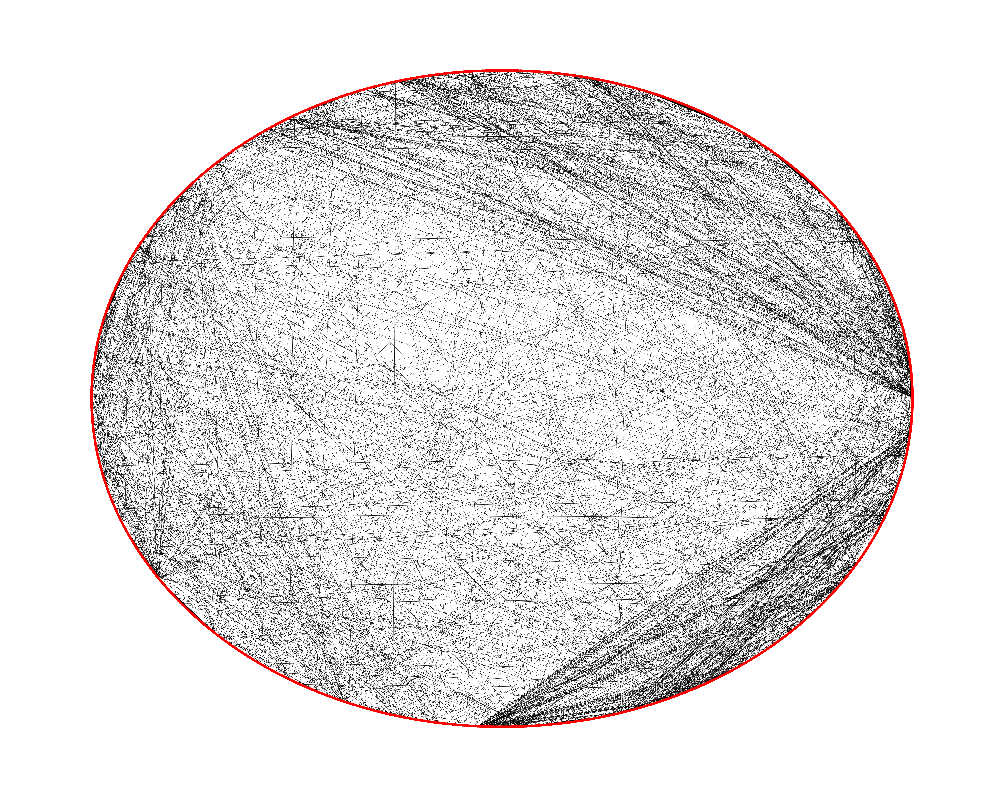

In [7]:
lang_g = nx.from_pandas_dataframe(all_lang, 'from_new', 'to', edge_attr = 'language')
de_g = nx.from_pandas_dataframe(de_twitch_data, 'from_new', 'to', edge_attr = 'language')
en_g = nx.from_pandas_dataframe(en_twitch_data, 'from_new', 'to', edge_attr = 'language')
ru_g = nx.from_pandas_dataframe(ru_twitch_data, 'from_new', 'to', edge_attr = 'language')

figure(figsize=(100, 80))
nx.draw_shell(lang_g, with_labels=False)

## Centrality Analysis

### Log-Log Plot

Log-log plots are a type histogram where both the degree and frequency (rather than count) are on base 10 logarithmic axis. In reading this chart, consider that one variable will change as a constant power (exponent) of the other. In this log-log plot, we observe that as the degrees of connection increase, the frequency or density of nodes decreases nearly exponentially from $10^0$ through $10^1$ across all languages, and flattens out in all languages as it approaches $10^3$. 

Text(0,0.5,'Frequency')

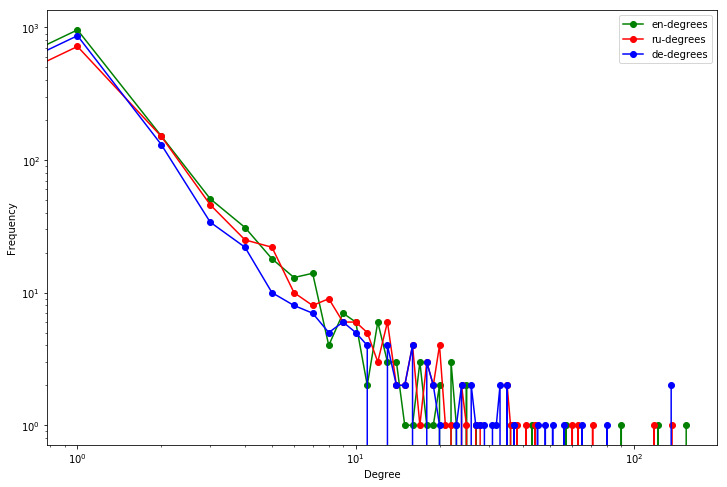

In [8]:
en_degree_freq = nx.degree_histogram(en_g)
ru_degree_freq = nx.degree_histogram(ru_g)
de_degree_freq = nx.degree_histogram(de_g)
degrees = range(len(en_degree_freq))
plt.figure(figsize=(12, 8)) 
plt.loglog(range(len(en_degree_freq)), en_degree_freq, 'go-', label='en-degrees') 
plt.loglog(range(len(ru_degree_freq)), ru_degree_freq, 'ro-', label='ru-degrees')
plt.loglog(range(len(de_degree_freq)), de_degree_freq, 'bo-', label='de-degrees')
plt.legend()
plt.xlabel('Degree')
plt.ylabel('Frequency')

## Visualizing Centralities

[A blog post](https://aksakalli.github.io/2017/07/17/network-centrality-measures-and-their-visualization.html) by Can Güney Aksakalli was incredibly instructive on how to visualize different Network centrality measures, as well as providing a good explainer on each. The methods below are his, but the interpretations are ours. The heat map networks that follow place all nodes on a scale from 0 to 1, based on their centrality value in the network. The higher the value, the closer to 1, this way it is easier to pull out the most "important" nodes and their connections.

### Visualizing Degree Centrality

Degree centrality is a straightforward measure observing the sheer number of connections between nodes. Each network's degree centrality are displayed below. We noticed in particular that English language streams seem to have more isloated parts of the network than the other two languages. We would hypothesize that this is due to English being a prolific language. There are more streamers that may have quite small followings conducting themselves in English carving out smaller and smaller niches leading to this disconnectedness. This is opposed to Russian and German who may have few streamers in their respective languages, and therefore garner more connections because the market isn't completely saturated. 

When observing some descriptive statistics of these centralities, this appears to bear out. Below is the complete list of nodes with their degrees and degree centralities as well as the calculated means, and median for degrees in each language. English has fewer mean and median degrees than the other two languages.

In part because of the size of these networks, the degree centrality measures are quite low and likely not very meaningful. While English continues to be the lowest on average across these measures, the top record in the network is an English speaker (EN93).

In [9]:
deg = nx.degree(lang_g)
degrees_list = list(deg.items())
degrees_list_sort = sorted(degrees_list, key=lambda tup: tup[1], reverse=True)

print(tabulate(degrees_list_sort, headers = ['ID', 'Degree'],tablefmt='fancy_grid'))

╒════════╤══════════╕
│ ID     │   Degree │
╞════════╪══════════╡
│ EN93   │      154 │
├────────┼──────────┤
│ RU6    │      137 │
├────────┼──────────┤
│ DE21   │      136 │
├────────┼──────────┤
│ DE27   │      136 │
├────────┼──────────┤
│ EN24   │      122 │
├────────┼──────────┤
│ RU57   │      118 │
├────────┼──────────┤
│ EN26   │       90 │
├────────┼──────────┤
│ DE11   │       80 │
├────────┼──────────┤
│ RU74   │       71 │
├────────┼──────────┤
│ DE72   │       65 │
├────────┼──────────┤
│ RU3219 │       63 │
├────────┼──────────┤
│ RU10   │       60 │
├────────┼──────────┤
│ EN23   │       57 │
├────────┼──────────┤
│ DE65   │       56 │
├────────┼──────────┤
│ DE60   │       51 │
├────────┼──────────┤
│ DE16   │       48 │
├────────┼──────────┤
│ DE42   │       45 │
├────────┼──────────┤
│ RU91   │       44 │
├────────┼──────────┤
│ EN147  │       43 │
├────────┼──────────┤
│ RU97   │       41 │
├────────┼──────────┤
│ RU70   │       38 │
├────────┼──────────┤
│ 7787   │

In [10]:
degree_df = pd.DataFrame(degrees_list)
print("German Mean Degree", str(round(degree_df[degree_df[0].str.contains("DE",na=False)][1].mean(),5)))
print("Russian Mean Degree", str(round(degree_df[degree_df[0].str.contains("RU",na=False)][1].mean(),5)))
print("English Mean Degree", str(round(degree_df[degree_df[0].str.contains("EN",na=False)][1].mean(),5)))

German Mean Degree 18.51852
Russian Mean Degree 14.85149
English Mean Degree 9.74026


In [11]:
degree_df = pd.DataFrame(degrees_list)
print("German Median Degree", str(degree_df[degree_df[0].str.contains("DE",na=False)][1].median()))
print("Russian Median Degree", str(degree_df[degree_df[0].str.contains("RU",na=False)][1].median()))
print("English Median Degree", str(degree_df[degree_df[0].str.contains("EN",na=False)][1].median()))

German Median Degree 11.0
Russian Median Degree 9.0
English Median Degree 5.0


In [12]:
degreecent = nx.degree_centrality(lang_g)
degreecent_sort = sorted(degreecent.items(), key=itemgetter(1), reverse=True)
print(tabulate(degreecent_sort, headers = ['ID', 'Degree Centrality'],tablefmt='fancy_grid'))

╒════════╤═════════════════════╕
│ ID     │   Degree Centrality │
╞════════╪═════════════════════╡
│ EN93   │         0.0496614   │
├────────┼─────────────────────┤
│ RU6    │         0.0441793   │
├────────┼─────────────────────┤
│ DE21   │         0.0438568   │
├────────┼─────────────────────┤
│ DE27   │         0.0438568   │
├────────┼─────────────────────┤
│ EN24   │         0.0393421   │
├────────┼─────────────────────┤
│ RU57   │         0.0380522   │
├────────┼─────────────────────┤
│ EN26   │         0.0290229   │
├────────┼─────────────────────┤
│ DE11   │         0.0257981   │
├────────┼─────────────────────┤
│ RU74   │         0.0228958   │
├────────┼─────────────────────┤
│ DE72   │         0.020961    │
├────────┼─────────────────────┤
│ RU3219 │         0.020316    │
├────────┼─────────────────────┤
│ RU10   │         0.0193486   │
├────────┼─────────────────────┤
│ EN23   │         0.0183812   │
├────────┼─────────────────────┤
│ DE65   │         0.0180587   │
├────────┼

In [13]:
degreecent_df = pd.DataFrame.from_dict(degreecent, orient='index')
degreecent_df = degreecent_df.reset_index()
print("German Mean Degree Centrality", str(round(degreecent_df[degreecent_df['index'].str.contains("DE",na=False)][0].mean(),6)))
print("Russian Mean Degree Centrality", str(round(degreecent_df[degreecent_df['index'].str.contains("RU",na=False)][0].mean(),6)))
print("English Mean Degree Centrality", str(round(degreecent_df[degreecent_df['index'].str.contains("EN",na=False)][0].mean(),6)))

German Mean Degree Centrality 0.005972
Russian Mean Degree Centrality 0.004789
English Mean Degree Centrality 0.003141


In [14]:
def draw(G, pos, measures, measure_name):
    
    nodes = nx.draw_networkx_nodes(G, pos, node_size=400, cmap=plt.cm.plasma, 
                                   node_color=list(measures.values()),
                                   alpha = 0.25,
                                   nodelist=measures.keys())
#     nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1, base=10))
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    # labels = nx.draw_networkx_labels(G, pos)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(measure_name)
    plt.colorbar(nodes)
    plt.axis('off')
    plt.show()

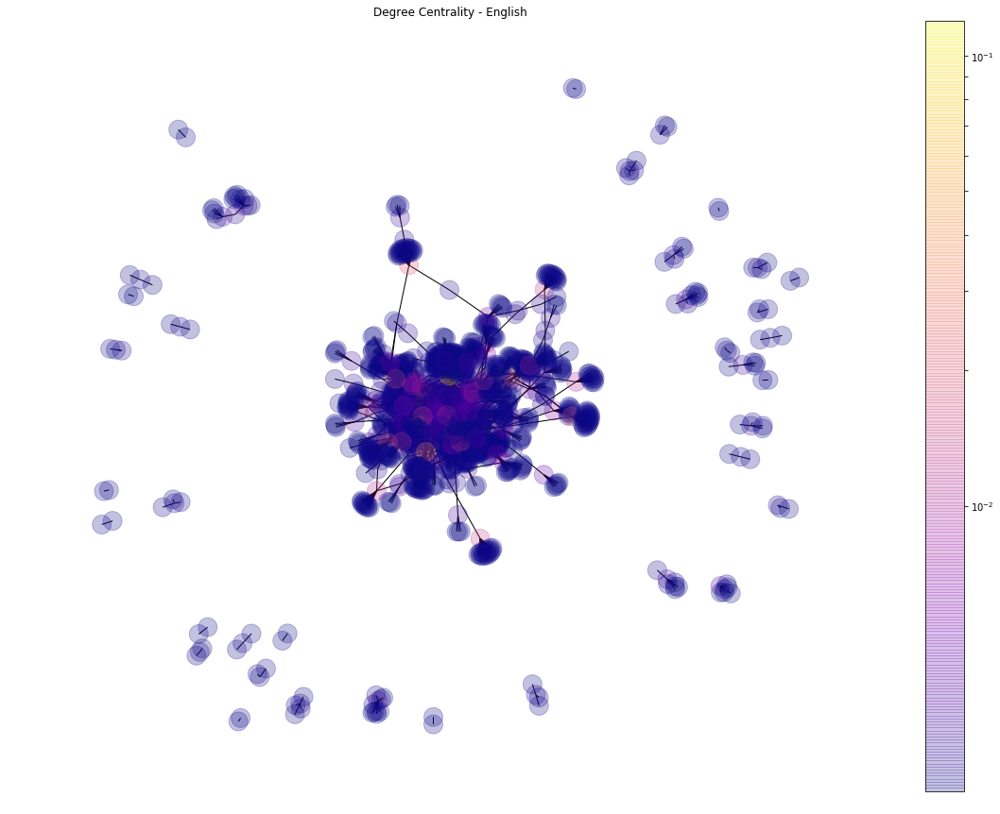

In [15]:
pos = nx.spring_layout(en_g)
plt.figure(figsize=(20,15))
draw(en_g, pos, nx.degree_centrality(en_g), 'Degree Centrality - English')

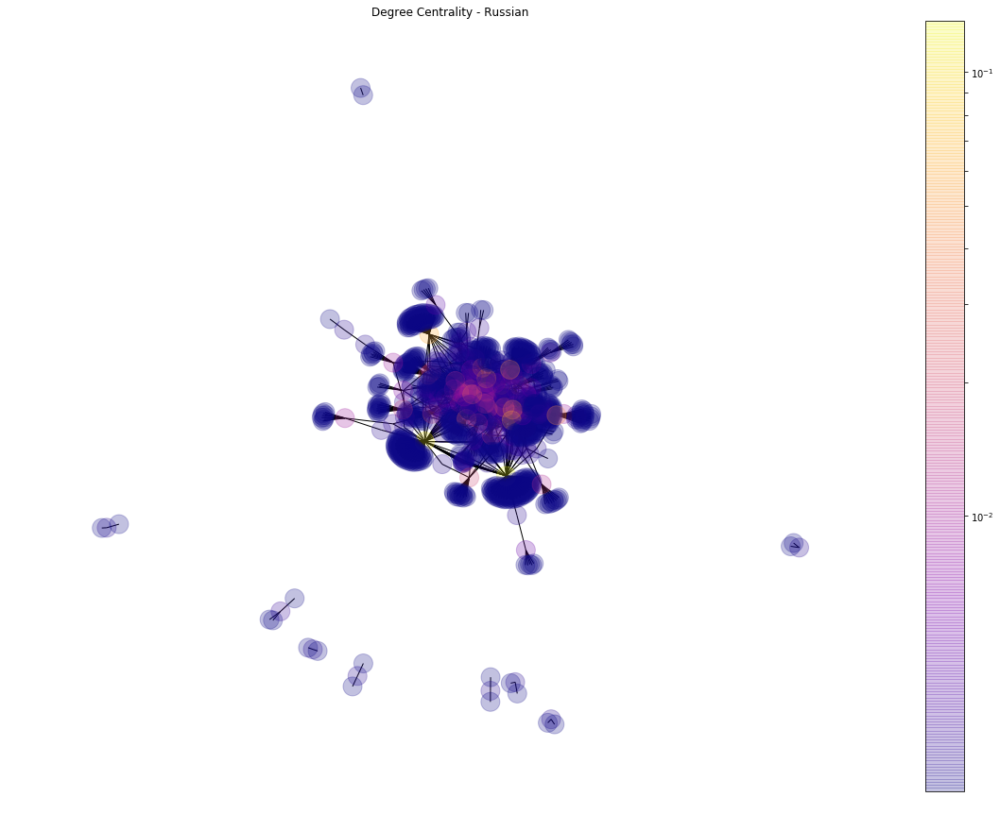

In [16]:
# pos = nx.spring_layout(ru_g, seed=675)
pos = nx.spring_layout(ru_g)
plt.figure(figsize=(20,15))
draw(ru_g, pos, nx.degree_centrality(ru_g), 'Degree Centrality - Russian')

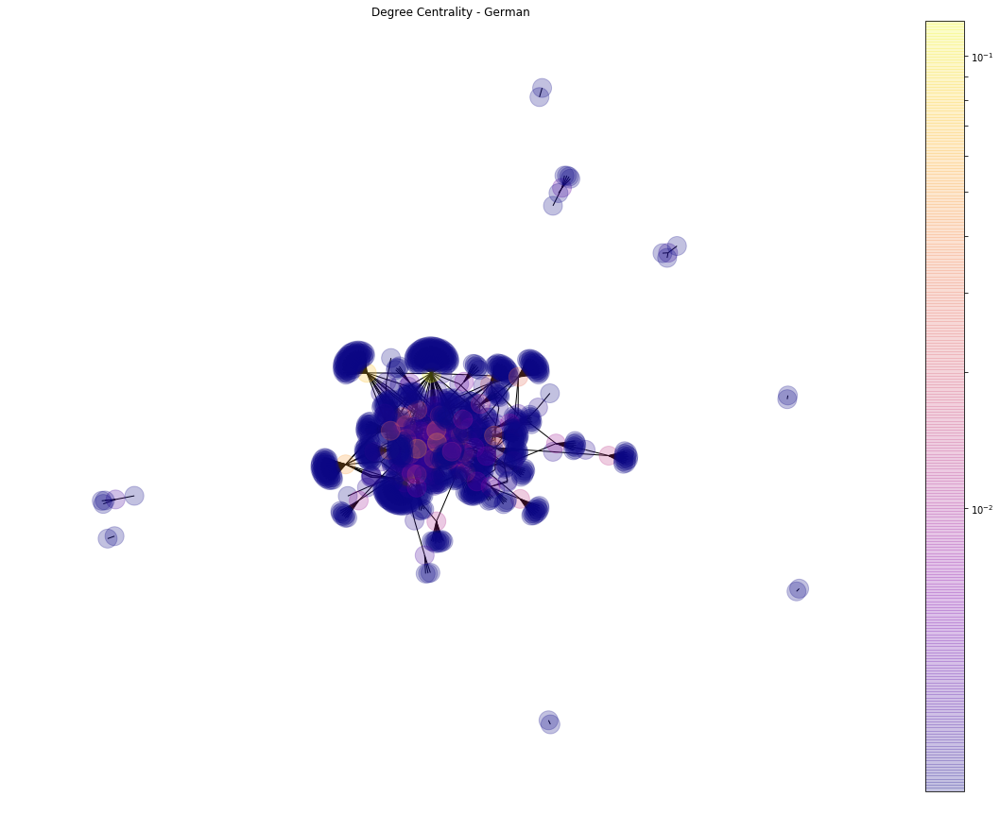

In [17]:
# pos = nx.spring_layout(de_g, seed=675)
pos = nx.spring_layout(de_g)
plt.figure(figsize=(20,15))
draw(de_g, pos, nx.degree_centrality(de_g), 'Degree Centrality - German')

### Visualizing Eigenvector Centrality

Eigenvector centrality is a measure of node "influence." It is calculated in relationship to neighboring nodes and their importance in the network. In the below network maps, which have the same shape as the above, the colors reflecting node influence shift from central nodes in degree centrality to the nodes connected to them. This demonstrates the similar shift from degree to eigenvector centrality--from importance to influence.  

In [18]:
eigenvec = nx.eigenvector_centrality_numpy(lang_g)
eigenvec_sort = sorted(eigenvec.items(), key=itemgetter(1), reverse=True)
print(tabulate(eigenvec_sort, headers = ['ID', 'Eigenvector'],tablefmt='fancy_grid'))

╒════════╤═══════════════╕
│ ID     │   Eigenvector │
╞════════╪═══════════════╡
│ EN93   │   0.427863    │
├────────┼───────────────┤
│ DE21   │   0.350605    │
├────────┼───────────────┤
│ RU6    │   0.198877    │
├────────┼───────────────┤
│ DE27   │   0.165398    │
├────────┼───────────────┤
│ DE72   │   0.148919    │
├────────┼───────────────┤
│ EN24   │   0.133507    │
├────────┼───────────────┤
│ RU57   │   0.109596    │
├────────┼───────────────┤
│ DE16   │   0.0994182   │
├────────┼───────────────┤
│ EN26   │   0.0924057   │
├────────┼───────────────┤
│ 1276   │   0.0877319   │
├────────┼───────────────┤
│ 1638   │   0.0763608   │
├────────┼───────────────┤
│ 7787   │   0.0757972   │
├────────┼───────────────┤
│ 2464   │   0.0752261   │
├────────┼───────────────┤
│ DE74   │   0.0726421   │
├────────┼───────────────┤
│ DE60   │   0.0715714   │
├────────┼───────────────┤
│ 8803   │   0.0697427   │
├────────┼───────────────┤
│ 5893   │   0.0687558   │
├────────┼───────────────┤
│

In [19]:
eigenvec_df = pd.DataFrame.from_dict(eigenvec, orient='index')
eigenvec_df = eigenvec_df.reset_index()

print("German Mean Eigenvector Centrality", str(round(eigenvec_df[eigenvec_df['index'].str.contains("DE",na=False)][0].mean(),5)))
print("Russian Mean Eigenvector Centrality", str(round(eigenvec_df[eigenvec_df['index'].str.contains("RU",na=False)][0].mean(),5)))
print("English Mean Eigenvector Centrality", str(round(eigenvec_df[eigenvec_df['index'].str.contains("EN",na=False)][0].mean(),5)))

German Mean Eigenvector Centrality 0.02293
Russian Mean Eigenvector Centrality 0.01095
English Mean Eigenvector Centrality 0.00797


In [20]:
def draw(G, pos, measures, measure_name):
    
    nodes = nx.draw_networkx_nodes(G, pos, node_size=400, cmap=plt.cm.cividis, 
                                   node_color=list(measures.values()),
                                   alpha = 0.25,
                                   nodelist=measures.keys())
#     nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1, base=10))
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    # labels = nx.draw_networkx_labels(G, pos)
    edges = nx.draw_networkx_edges(G, pos)

    plt.title(measure_name)
    plt.colorbar(nodes)
    plt.axis('off')
    plt.show()

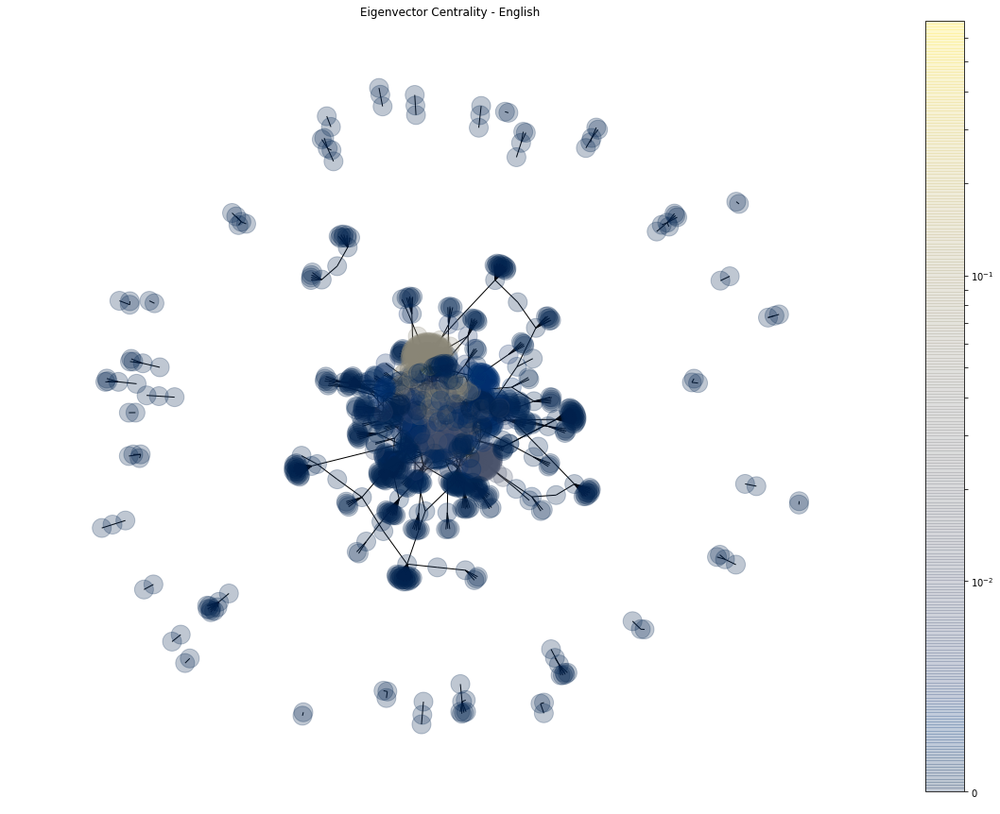

In [21]:
pos = nx.spring_layout(en_g)
plt.figure(figsize=(20,15))
draw(en_g, pos, nx.eigenvector_centrality_numpy(en_g), 'Eigenvector Centrality - English')

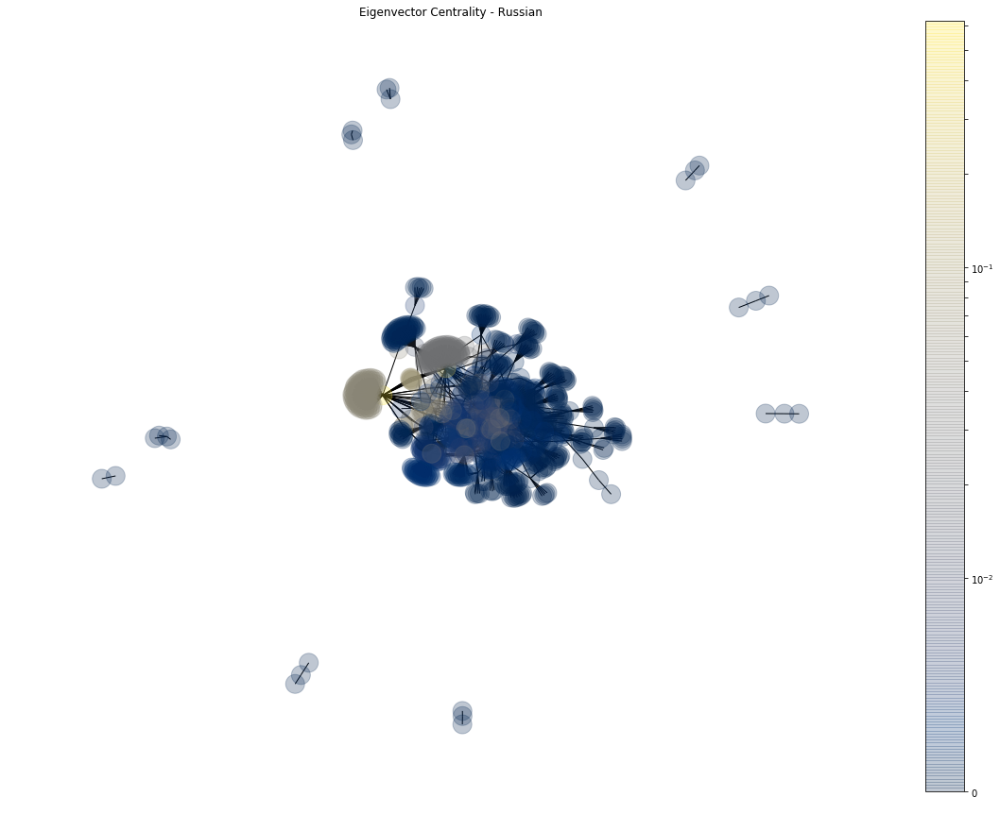

In [22]:
pos = nx.spring_layout(ru_g)
plt.figure(figsize=(20,15))
draw(ru_g, pos, nx.eigenvector_centrality_numpy(ru_g), 'Eigenvector Centrality - Russian')

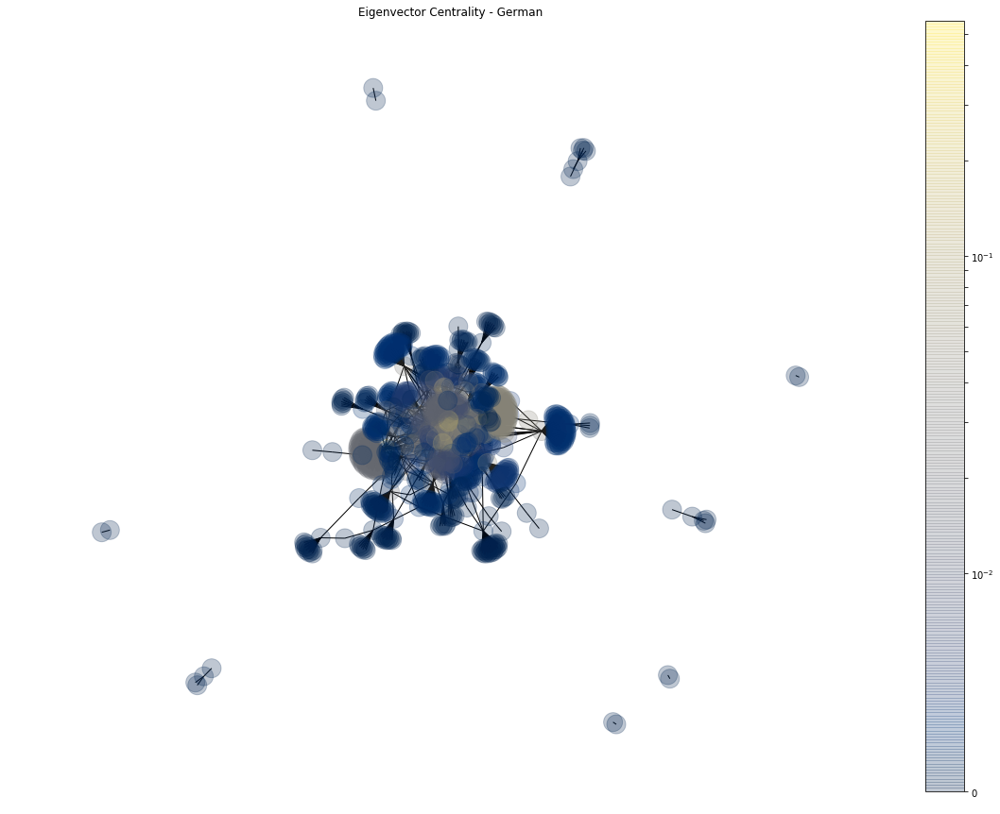

In [23]:
pos = nx.spring_layout(de_g)
plt.figure(figsize=(20,15))
draw(de_g, pos, nx.eigenvector_centrality_numpy(de_g), 'Eigenvector Centrality - German')

## [YouTube Presentation Link](https://youtu.be/w9XIsVJr9mc)